<a href="https://colab.research.google.com/github/SankalpJoshi2910/IBM_DS_CAPSTONEPROJECT/blob/main/The_Battle_of_Neighborhoods_(Week_2).ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

### Importing all Required Libraries###

In [ ]:
import requests

import pandas as pd
pd.set_option('display.max_columns', 10)
pd.set_option('display.max_rows', 10)

import numpy as np

import warnings
warnings.filterwarnings("ignore")

!pip install geopy
from geopy.geocoders import Nominatim

import folium

from sklearn.cluster import KMeans

import matplotlib.cm as cm
import matplotlib.colors as colors

### Extracting Bangalore Data with their Latitude and Longitude###

In [ ]:
url = 'https://www.mapsofindia.com/pincode/india/karnataka/bangalore/'
html = requests.get(url).content
df_list = pd.read_html(html)
df = df_list[-1]
df.head()


,Pincode Details,Pincode Details.1,Pincode Details.2,Pincode Details.3
0,Location,Pincode,State,District
1,A F station yelahanka,560063,Karnataka,Bangalore
2,Adugodi,560030,Karnataka,Bangalore
3,Agara,560034,Karnataka,Bangalore
4,Agram,560007,Karnataka,Bangalore


In [ ]:
df.rename({'Pincode Details':'Area','Pincode Details.1':"Pincode",'Pincode Details.2':'State','Pincode Details.3':'District'},axis =1 , inplace =True)
df = df.drop(df.index[0])
df.head()

,Area,Pincode,State,District
1,A F station yelahanka,560063,Karnataka,Bangalore
2,Adugodi,560030,Karnataka,Bangalore
3,Agara,560034,Karnataka,Bangalore
4,Agram,560007,Karnataka,Bangalore
5,Air Force hospital,560007,Karnataka,Bangalore


In [ ]:
# Extracting Latitude and Longitude of a Particular 

address = 'Mathikere, Bangalore'
geolocator = Nominatim(user_agent="nd_explorer")
location = geolocator.geocode(address)
latitude = location.latitude
longitude = location.longitude
print('The geograpical coordinate of Mathikere {}, {}.'.format(latitude, longitude))

The geograpical coordinate of Mathikere 13.0328884, 77.557374.


In [ ]:
# New data with Lat & Longi Column
df1 = df

df1["Latitude"] = "Nan"
df1["Longitude"] = "Nan"

df1.head()

,Area,Pincode,State,District,Latitude,Longitude
1,A F station yelahanka,560063,Karnataka,Bangalore,Nan,Nan
2,Adugodi,560030,Karnataka,Bangalore,Nan,Nan
3,Agara,560034,Karnataka,Bangalore,Nan,Nan
4,Agram,560007,Karnataka,Bangalore,Nan,Nan
5,Air Force hospital,560007,Karnataka,Bangalore,Nan,Nan


Loop to extract Geo Location of each area and adding them to the dataframe

In [ ]:
# Geolocation Extract Loop

lat = []
longi = []
for i in df1['Area']:
  row = i +',Bangalore'
  addr = geolocator.geocode(row, timeout=10)
  if addr is None:
    lat.append("NaN")
    longi.append("NaN")
  else:
    lat.append(addr.latitude)
    longi.append(addr.longitude)

In [ ]:
# Adding Location to Dataframe
print(len(lat))
print(len(longi))

df1['Latitude'] = lat
df1['Longitude'] = longi
df1.head()


294
294


,Area,Pincode,State,District,Latitude,Longitude
1,A F station yelahanka,560063,Karnataka,Bangalore,NaN,NaN
2,Adugodi,560030,Karnataka,Bangalore,12.9428,77.6104
3,Agara,560034,Karnataka,Bangalore,13.0387,77.6468
4,Agram,560007,Karnataka,Bangalore,NaN,NaN
5,Air Force hospital,560007,Karnataka,Bangalore,12.964,77.6275


### Cleaning Bangalore Data###
Removing NaN values

In [ ]:
df1 = df[df1['Latitude'] != "NaN"]
len(df1)

192

Removal of Unwanted Columns

In [ ]:
df1.drop(['State'],axis =1, inplace = True)
df1.head()

,Area,Pincode,District,Latitude,Longitude
2,Adugodi,560030,Bangalore,12.9428,77.6104
3,Agara,560034,Bangalore,13.0387,77.6468
5,Air Force hospital,560007,Bangalore,12.964,77.6275
6,Amruthahalli,560092,Bangalore,13.0665,77.5966
7,Anandnagar,560024,Bangalore,13.0334,77.5895


Renaming Columns

In [ ]:
df1.rename({'Pincode': 'Postal Code','District': 'City'}, axis=1, inplace = True)
df1.head()

,Area,Postal Code,City,Latitude,Longitude
2,Adugodi,560030,Bangalore,12.9428,77.6104
3,Agara,560034,Bangalore,13.0387,77.6468
5,Air Force hospital,560007,Bangalore,12.964,77.6275
6,Amruthahalli,560092,Bangalore,13.0665,77.5966
7,Anandnagar,560024,Bangalore,13.0334,77.5895


Resetting Index


In [ ]:
df1.set_index("Area", inplace = True)
df1.reset_index()
df2 = df1.reset_index()
print(df2.shape)

(192, 5)


Final Bangalore City Data with all its Areas Postal Code and their Geo Location( Latitude & Longitude )

In [ ]:
df2.to_csv("Bangalore Postal Geolocations.csv")

## Plotting Geolocation using Folium

In [ ]:
df3 = df2

In [ ]:
df3 = df3.loc[(df3['Latitude'] >= 12.74) & (df3['Latitude'] <= 13.3)]
df3 = df3.loc[(df3['Longitude'] >= 77.44) & (df3['Longitude'] <= 77.82)]

In [ ]:
df3.shape

(181, 5)

In [ ]:
Bangalore_map = folium.Map(location=[12.972442,77.580643],zoom_start=10)

for lat,lng,area in zip(df3['Latitude'],df3['Longitude'],df3['Area']):
    label = '{},{},{}'.format(area,lat,lng)
    label = folium.Popup(label, parse_html=True)
    folium.CircleMarker(
    [lat,lng],
    radius=5,
    popup=label,
    color='blue',
    fill=True,
    fill_color='#3186cc',
    fill_opacity=0.7,
    parse_html=False).add_to(Bangalore_map)
Bangalore_map


# Chennai Data Extraction and Visualization

In [ ]:
url1 = 'https://www.mapsofindia.com/pincode/india/telangana/hyderabad/'
html1 = requests.get(url1).content
df_list1 = pd.read_html(html1)
ndf = df_list1[-1]
ndf.head()

,Pincode Details,Pincode Details.1,Pincode Details.2,Pincode Details.3
0,Location,Pincode,State,District
1,A.G.college,500030,Telangana,Hyderabad
2,A.Gs office,500004,Telangana,Hyderabad
3,A.Gs. staff quarters,500045,Telangana,Hyderabad
4,Administrative Buildings,500007,Telangana,Hyderabad


In [ ]:
ndf.rename({'Pincode Details':'Area','Pincode Details.1':"Pincode",'Pincode Details.2':'State','Pincode Details.3':'District'},axis =1 , inplace =True)
c_df = ndf.drop(ndf.index[0])
c_df.head()

,Area,Pincode,State,District
1,A.G.college,500030,Telangana,Hyderabad
2,A.Gs office,500004,Telangana,Hyderabad
3,A.Gs. staff quarters,500045,Telangana,Hyderabad
4,Administrative Buildings,500007,Telangana,Hyderabad
5,Afzalgunj,500012,Telangana,Hyderabad


In [ ]:
# New data with Lat & Longi Column
c_df1 = c_df

c_df1["Latitude"] = "Nan"
c_df1["Longitude"] = "Nan"

c_df1.head()

,Area,Pincode,State,District,Latitude,Longitude
1,A.G.college,500030,Telangana,Hyderabad,Nan,Nan
2,A.Gs office,500004,Telangana,Hyderabad,Nan,Nan
3,A.Gs. staff quarters,500045,Telangana,Hyderabad,Nan,Nan
4,Administrative Buildings,500007,Telangana,Hyderabad,Nan,Nan
5,Afzalgunj,500012,Telangana,Hyderabad,Nan,Nan


Extracting Grolocation of  Chennai Area

In [ ]:
# Geolocation Extract Loop

c_lat = []
c_longi = []
for i in c_df1['Area']:
  row = i +',Hyderabad'
  addr = geolocator.geocode(row, timeout=10)
  if addr is None:
    c_lat.append("NaN")
    c_longi.append("NaN")
  else:
    c_lat.append(addr.latitude)
    c_longi.append(addr.longitude)

In [ ]:
# Adding Location to Dataframe
print(len(c_lat))
print(len(c_longi))

c_df1['Latitude'] = c_lat
c_df1['Longitude'] = c_longi
c_df1.head()

228
228


,Area,Pincode,State,District,Latitude,Longitude
1,A.G.college,500030,Telangana,Hyderabad,NaN,NaN
2,A.Gs office,500004,Telangana,Hyderabad,NaN,NaN
3,A.Gs. staff quarters,500045,Telangana,Hyderabad,NaN,NaN
4,Administrative Buildings,500007,Telangana,Hyderabad,NaN,NaN
5,Afzalgunj,500012,Telangana,Hyderabad,17.3735,78.4763


In [ ]:
c_df1 = c_df[c_df1['Latitude'] != "NaN"]
len(c_df1)

115

In [ ]:
c_df1.drop(['State'],axis =1, inplace = True)
c_df1.head()

,Area,Pincode,District,Latitude,Longitude
5,Afzalgunj,500012,Hyderabad,17.3735,78.4763
6,Aliabad,500015,Hyderabad,17.3456,78.4727
8,Amberpet,500013,Hyderabad,17.3903,78.5165
12,Andhra Mahila sabha,500044,Hyderabad,17.4061,78.5153
18,Ashoknagar,500020,Hyderabad,17.4264,78.4349


In [ ]:
c_df1.rename({'Pincode': 'Postal Code','District': 'City'}, axis=1, inplace = True)
c_df1.head()

,Area,Postal Code,City,Latitude,Longitude
5,Afzalgunj,500012,Hyderabad,17.3735,78.4763
6,Aliabad,500015,Hyderabad,17.3456,78.4727
8,Amberpet,500013,Hyderabad,17.3903,78.5165
12,Andhra Mahila sabha,500044,Hyderabad,17.4061,78.5153
18,Ashoknagar,500020,Hyderabad,17.4264,78.4349


In [ ]:
c_df1.set_index("Area", inplace = True)
c_df1.reset_index()
c_df2 = c_df1.reset_index()
print(c_df2.shape)

(115, 5)


In [ ]:
c_df2.to_csv("Chennai Postal Geolocations.csv")

In [ ]:
Hyderabad_map = folium.Map(location=[17.387140,78.491684],zoom_start=10)

for lat,lng,area in zip(c_df2['Latitude'],c_df2['Longitude'],c_df2['Area']):
    label = '{},{},{}'.format(area,lat,lng)
    label = folium.Popup(label, parse_html=True)
    folium.CircleMarker(
    [lat,lng],
    radius=5,
    popup=label,
    color='green',
    fill=True,
    fill_color='#3186cc',
    fill_opacity=0.7,
    parse_html=False).add_to(Hyderabad_map)
Hyderabad_map

# Merging of Both Dataset

In [ ]:
FD = pd.concat([df3,c_df2], ignore_index=True, sort=False)

In [ ]:
FD.shape

(296, 5)

In [ ]:
FD.head()

,Area,Postal Code,City,Latitude,Longitude
0,Adugodi,560030,Bangalore,12.9428,77.6104
1,Agara,560034,Bangalore,13.0387,77.6468
2,Air Force hospital,560007,Bangalore,12.964,77.6275
3,Amruthahalli,560092,Bangalore,13.0665,77.5966
4,Anandnagar,560024,Bangalore,13.0334,77.5895


In [ ]:
India_map = folium.Map(location=[16.5,77.5],zoom_start=6)

for lat,lng,area in zip(FD['Latitude'],FD['Longitude'],FD['Area']):
    label = '{},{},{}'.format(area,lat,lng)
    label = folium.Popup(label, parse_html=True)
    folium.CircleMarker(
    [lat,lng],
    radius=5,
    popup=label,
    color='red',
    fill=True,
    fill_color='#3186cc',
    fill_opacity=0.7,
    parse_html=False).add_to(India_map)
India_map

In [ ]:
FD.to_csv('Merged Data.csv')

# Foursquare Location Data

In [ ]:
# Define Foursquare Credentials and Version
CLIENT_ID = 'UTJRVHLJXBTOQCYHOQ2HYYANUBTV1RV4H5RC0FGNK2N0QTLJ' # your Foursquare ID
CLIENT_SECRET = 'FFLDITXMPRZIIFFHKT2S0RFU0WV420LJVWGQZV13H2R1ICFF' # your Foursquare Secret
VERSION = '20180605' # Foursquare API version

In [ ]:
# function to loop each neighborhood and get the 100 venues within 1km.
def getNearbyVenues(cities, names, latitudes, longitudes, radius=1000, LIMIT = 100):
    
    venues_list=[]
    for city, name, lat, lng in zip(cities, names, latitudes, longitudes):  
        # create the API request URL
        url = 'https://api.foursquare.com/v2/venues/explore?&client_id={}&client_secret={}&v={}&ll={},{}&radius={}&limit={}'.format(
            CLIENT_ID, 
            CLIENT_SECRET, 
            VERSION, 
            lat, 
            lng, 
            radius, 
            LIMIT)
            
        # make the GET request
        results = requests.get(url).json()["response"]['groups'][0]['items']
        
        # return only relevant information for each nearby venue
        venues_list.append([(
            city,
            name, 
            lat, 
            lng, 
            v['venue']['name'], 
            v['venue']['location']['lat'], 
            v['venue']['location']['lng'],  
            v['venue']['categories'][0]['name']) for v in results])
        

    nearby_venues = pd.DataFrame([item for venue_list in venues_list for item in venue_list])
    nearby_venues.columns = ['City', 'Neighborhood', 
                  'Neighborhood Latitude', 
                  'Neighborhood Longitude', 
                  'Venue', 
                  'Venue Latitude', 
                  'Venue Longitude', 
                  'Venue Category']
    
    return(nearby_venues)

In [ ]:
Neighbourhood = getNearbyVenues(cities=FD['City'],
                        names=FD['Area'],
                        latitudes=FD['Latitude'],
                        longitudes=FD['Longitude']
                                  )
                      

In [ ]:
Neighbourhood.head()

,City,Neighborhood,Neighborhood Latitude,Neighborhood Longitude,Venue,Venue Latitude,Venue Longitude,Venue Category
0,Bangalore,Adugodi,12.942847,77.610416,PVR IMAX,12.934595,77.611321,Movie Theater
1,Bangalore,Adugodi,12.942847,77.610416,Lot Like Crêpes,12.936421,77.613284,Creperie
2,Bangalore,Adugodi,12.942847,77.610416,Koramangala Social,12.935518,77.614097,Lounge
3,Bangalore,Adugodi,12.942847,77.610416,Tommy Hilfiger,12.934552,77.611347,Clothing Store
4,Bangalore,Adugodi,12.942847,77.610416,PVR Cinemas,12.934389,77.611184,Multiplex


In [ ]:
Neighbourhood.shape

(6570, 8)

In [ ]:
print(Neighbourhood.isnull().sum())

City                      0
Neighborhood              0
Neighborhood Latitude     0
Neighborhood Longitude    0
Venue                     0
Venue Latitude            0
Venue Longitude           0
Venue Category            0
dtype: int64


In [ ]:
print(Neighbourhood.duplicated().sum())

0


In [ ]:
Neighbourhood.to_csv('Combined Neighbourhood Data.csv')

## Exploratory Data Analysis ##

In [ ]:
NP = Neighbourhood

In [ ]:
NP.head()

,City,Neighborhood,Neighborhood Latitude,Neighborhood Longitude,Venue,Venue Latitude,Venue Longitude,Venue Category
0,Bangalore,Adugodi,12.942847,77.610416,PVR IMAX,12.934595,77.611321,Movie Theater
1,Bangalore,Adugodi,12.942847,77.610416,Lot Like Crêpes,12.936421,77.613284,Creperie
2,Bangalore,Adugodi,12.942847,77.610416,Koramangala Social,12.935518,77.614097,Lounge
3,Bangalore,Adugodi,12.942847,77.610416,Tommy Hilfiger,12.934552,77.611347,Clothing Store
4,Bangalore,Adugodi,12.942847,77.610416,PVR Cinemas,12.934389,77.611184,Multiplex


In [ ]:
n = len(NP.Neighborhood.unique())
print('The venues dataset has venues for {} unique neighbourhoods.'.format(n))

The venues dataset has venues for 284 unique neighbourhoods.


In [ ]:
n_ban = len(NP[NP['City']=='Bangalore'].Neighborhood.unique())
n_hyd = len(NP[NP['City']=='Hyderabad'].Neighborhood.unique())

print(n_ban)
print(n_hyd)

171
114


In [ ]:
# check how many venues are returned for each neighborhood
venue_count = NP.groupby(['City', 'Neighborhood']).count().reset_index()
venue_count

,City,Neighborhood,Neighborhood Latitude,Neighborhood Longitude,Venue,Venue Latitude,Venue Longitude,Venue Category
0,Bangalore,Adugodi,47,47,47,47,47,47
1,Bangalore,Agara,7,7,7,7,7,7
2,Bangalore,Air Force hospital,10,10,10,10,10,10
3,Bangalore,Amruthahalli,15,15,15,15,15,15
4,Bangalore,Anandnagar,14,14,14,14,14,14
...,...,...,...,...,...,...,...,...
280,Hyderabad,Vidyanagar,13,13,13,13,13,13
281,Hyderabad,Vijay Nagar colony,21,21,21,21,21,21
282,Hyderabad,Yakutpura,4,4,4,4,4,4
283,Hyderabad,Yousufguda,12,12,12,12,12,12


In [ ]:
venue_count[venue_count.Venue == 100].shape

(7, 8)

### Unique Categories ###

In [ ]:
# find out how many unique categories are returned.
num_cat = len(NP['Venue Category'].unique())
print('There are {} uniques categories.'.format(num_cat))

There are 274 uniques categories.


In [ ]:
# venue categories by City
ban_cat = NP[NP['City'] == 'Bangalore']['Venue Category'].unique()
num_ban_cat = len(ban_cat)
hyd_cat = NP[NP['City'] == 'Hyderabad']['Venue Category'].unique()
num_hyd_cat = len(hyd_cat)
print('Bangalore has {} unique venue categories'.format(num_ban_cat))
print('Hyderabad has {} unique venue categories'.format(num_hyd_cat))

Bangalore has 246 unique venue categories
Hyderabad has 164 unique venue categories


## Visualization


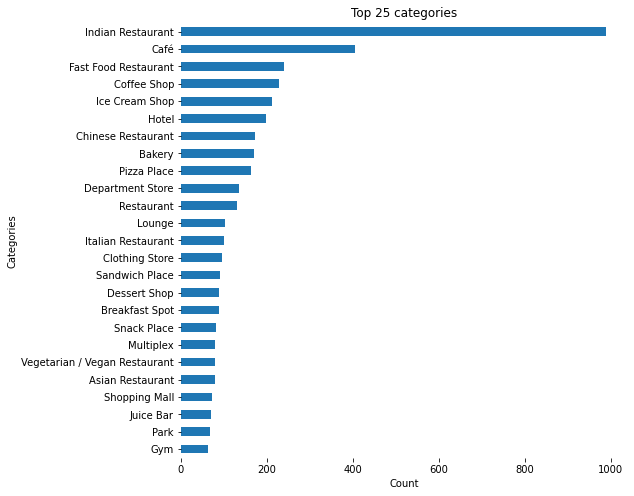

In [ ]:
# top 25 categories
top10_cat = NP['Venue Category'].value_counts().head(25)
ax1 = top10_cat.plot(kind = 'barh', figsize = (8, 8))
ax1.set_title('Top 25 categories')
ax1.set_xlabel('Count')
ax1.set_ylabel('Categories')
ax1.invert_yaxis()
ax1.spines['top'].set_visible(False)
ax1.spines['right'].set_visible(False)
ax1.spines['bottom'].set_visible(False)
ax1.spines['left'].set_visible(False)

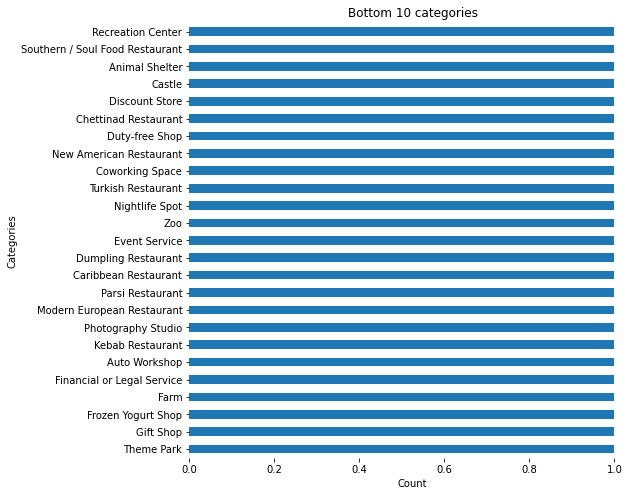

In [ ]:
# bottom 25 categories
bottom10_cat = NP['Venue Category'].value_counts().tail(25)
ax2 = bottom10_cat.plot(kind = 'barh', figsize = (8, 8))
ax2.set_title('Bottom 10 categories')
ax2.set_xlabel('Count')
ax2.set_ylabel('Categories')
ax2.invert_yaxis()
ax2.spines['top'].set_visible(False)
ax2.spines['right'].set_visible(False)
ax2.spines['bottom'].set_visible(False)
ax2.spines['left'].set_visible(False)

Let's take a look at all those categories whose count is 1

In [ ]:
cat_count = NP['Venue Category'].value_counts().to_frame().reset_index()
cat_count.columns = ['Venue Category', 'Count']
cat_count[cat_count.Count == 1]['Venue Category'].unique()

array(['Toll Booth', 'University', 'Mountain', 'Basketball Court',
       'Other Nightlife', 'Museum', 'Noodle House', 'Design Studio',
       'Food Service', 'Social Club', 'Bike Rental / Bike Share',
       'Butcher', 'Currency Exchange', 'Pakistani Restaurant',
       'Irish Pub', 'Chaat Place', 'Art Museum', 'Outdoors & Recreation',
       'Bagel Shop', 'Bridal Shop', 'Wine Shop', 'Laser Tag',
       'Lighthouse', 'Arts & Entertainment', 'Pool Hall',
       'English Restaurant', 'Bike Shop', 'Speakeasy', 'Henan Restaurant',
       'Dive Bar', 'Airport Food Court', 'Maharashtrian Restaurant',
       'Construction & Landscaping', 'Bus Line', 'Memorial Site',
       'Airport Terminal', 'Harbor / Marina', 'Recreation Center',
       'Southern / Soul Food Restaurant', 'Animal Shelter', 'Castle',
       'Discount Store', 'Chettinad Restaurant', 'Duty-free Shop',
       'New American Restaurant', 'Coworking Space', 'Turkish Restaurant',
       'Nightlife Spot', 'Zoo', 'Event Service', 'Du

###Top 10 categories for each Neighbourhood###

One Hot Encoding

In [ ]:
# one hot encoding
NP_onehot = pd.get_dummies(NP[['Venue Category']], prefix="", prefix_sep="")

# add 'Neighborhood' column and 'City/borough' column back to dataframe
NP_onehot['Neighborhood'] = NP['Neighborhood'] 

# move 'Neighborhood' column to the first column
Neighborhood = NP_onehot.pop('Neighborhood')
NP_onehot.insert(0, 'Neighborhood', Neighborhood)
NP_onehot.head()

,Neighborhood,ATM,Accessories Store,Afghan Restaurant,Airport,...,Wine Bar,Wine Shop,Women's Store,Yoga Studio,Zoo
0,Adugodi,0,0,0,0,...,0,0,0,0,0
1,Adugodi,0,0,0,0,...,0,0,0,0,0
2,Adugodi,0,0,0,0,...,0,0,0,0,0
3,Adugodi,0,0,0,0,...,0,0,0,0,0
4,Adugodi,0,0,0,0,...,0,0,0,0,0


Frequency of occurrence of each category

In [ ]:
NP_grouped = NP_onehot.groupby('Neighborhood').mean().reset_index()
NP_grouped.head()

,Neighborhood,ATM,Accessories Store,Afghan Restaurant,Airport,...,Wine Bar,Wine Shop,Women's Store,Yoga Studio,Zoo
0,Adugodi,0.0,0.0,0.0,0.0,...,0.0,0.0,0.000,0.0,0.0
1,Afzalgunj,0.0,0.0,0.0,0.0,...,0.0,0.0,0.125,0.0,0.0
2,Agara,0.0,0.0,0.0,0.0,...,0.0,0.0,0.000,0.0,0.0
3,Air Force hospital,0.0,0.0,0.0,0.0,...,0.0,0.0,0.000,0.0,0.0
4,Aliabad,0.0,0.0,0.0,0.0,...,0.0,0.0,0.000,0.0,0.0


Top 10 categories for each neighborhood

In [ ]:
#write a function to sort the venues in descending order.
def return_most_common_venues(row, num_top_venues):
    row_categories = row.iloc[1:]
    row_categories_sorted = row_categories.sort_values(ascending=False)
    
    return row_categories_sorted.index.values[0:num_top_venues]


In [ ]:
# create the new dataframe and display the top 10 venues for each neighborhood.
num_top_venues = 10

indicators = ['st', 'nd', 'rd']

# create columns according to number of top venues
columns = ['Neighborhood']
for ind in np.arange(num_top_venues):
    try:
        columns.append('{}{} Most Common Venue'.format(ind+1, indicators[ind]))
    except:
        columns.append('{}th Most Common Venue'.format(ind+1))

# create a new dataframe
neighborhoods_venues_sorted = pd.DataFrame(columns=columns)
neighborhoods_venues_sorted['Neighborhood'] = NP_grouped['Neighborhood']

n_grouped = NP_grouped.shape[0]
for ind in range(n_grouped):
    neighborhoods_venues_sorted.iloc[ind, 1:] = return_most_common_venues(NP_grouped.iloc[ind, :], num_top_venues)

neighborhoods_venues_sorted.head()

,Neighborhood,1st Most Common Venue,2nd Most Common Venue,3rd Most Common Venue,4th Most Common Venue,...,6th Most Common Venue,7th Most Common Venue,8th Most Common Venue,9th Most Common Venue,10th Most Common Venue
0,Adugodi,Indian Restaurant,Lounge,Café,Dessert Shop,...,Multiplex,Juice Bar,Donut Shop,Brewery,Bookstore
1,Afzalgunj,History Museum,Food Court,Food,Food Truck,...,Diner,Women's Store,Event Service,English Restaurant,Event Space
2,Agara,Pharmacy,Restaurant,Bakery,Music Venue,...,Garden,Coffee Shop,Electronics Store,Eastern European Restaurant,Duty-free Shop
3,Air Force hospital,Café,Juice Bar,South Indian Restaurant,Pizza Place,...,Bar,Gift Shop,Dry Cleaner,Discount Store,Dive Bar
4,Aliabad,Chinese Restaurant,Auto Garage,Gym,Food & Drink Shop,...,Snack Place,Asian Restaurant,Café,Smoke Shop,Ice Cream Shop


## K- Means Clustering

In [ ]:
# set up k means clustering
n = 4

NP_grouped_clustering = NP_grouped.drop('Neighborhood', 1)

kmeans = KMeans(init='k-means++', n_clusters=n, random_state=4).fit(NP_grouped_clustering)

# check cluster labels generated for each row in the dataframe
kmeans.labels_[0:10]

array([2, 2, 2, 0, 2, 1, 1, 1, 2, 3], dtype=int32)

In [ ]:
# create a new dataframe that includes the cluster as well as the top 10 venues for each neighborhood.

neighborhoods_venues_sorted.insert(0, 'Cluster Labels', kmeans.labels_)

ban_hyd_merged = NP.merge(neighborhoods_venues_sorted, on='Neighborhood')

In [ ]:
ban_hyd_merged.columns

Index(['City', 'Neighborhood', 'Neighborhood Latitude',
       'Neighborhood Longitude', 'Venue', 'Venue Latitude', 'Venue Longitude',
       'Venue Category', 'Cluster Labels', '1st Most Common Venue',
       '2nd Most Common Venue', '3rd Most Common Venue',
       '4th Most Common Venue', '5th Most Common Venue',
       '6th Most Common Venue', '7th Most Common Venue',
       '8th Most Common Venue', '9th Most Common Venue',
       '10th Most Common Venue'],
      dtype='object')

In [ ]:
# clusters on map of Manhattan
# set color scheme for the clusters
x = np.arange(n)
ys = [i + x + (i*x)**2 for i in range(n)]
colors_array = cm.rainbow(np.linspace(0, 1, len(ys)))
rainbow = [colors.rgb2hex(i) for i in colors_array]

# add markers to the map
markers_colors = []
for lat, lon, poi, cluster in zip(ban_hyd_merged['Neighborhood Latitude'], ban_hyd_merged['Neighborhood Longitude'], ban_hyd_merged['Neighborhood'], ban_hyd_merged['Cluster Labels']):
    label = folium.Popup(str(poi) + ' Cluster ' + str(cluster), parse_html=True)
    folium.CircleMarker(
        [lat, lon],
        radius=5,
        popup=label,
        color=rainbow[cluster-1],
        fill=True,
        fill_color=rainbow[cluster-1],
        fill_opacity=0.7).add_to(Bangalore_map)
Bangalore_map

In [ ]:
# Clusters on map of Seattle
# set color scheme for the clusters
x = np.arange(n)
ys = [i + x + (i*x)**2 for i in range(n)]
colors_array = cm.rainbow(np.linspace(0, 1, len(ys)))
rainbow = [colors.rgb2hex(i) for i in colors_array]

# add markers to the map
markers_colors = []
for lat, lon, poi, cluster in zip(ban_hyd_merged['Neighborhood Latitude'], ban_hyd_merged['Neighborhood Longitude'], ban_hyd_merged['Neighborhood'], ban_hyd_merged['Cluster Labels']):
    label = folium.Popup(str(poi) + ' Cluster ' + str(cluster), parse_html=True)
    folium.CircleMarker(
        [lat, lon],
        radius=5,
        popup=label,
        color=rainbow[cluster-1],
        fill=True,
        fill_color=rainbow[cluster-1],
        fill_opacity=0.7).add_to(Hyderabad_map)
Hyderabad_map

From the map above, we can see that the neighborhoods in Bangalore & Hyderabad are mostly in two clusters, which is cluster 1 and cluster 2.

Next we will print out the list of cluster 1 and cluster 2 to have a look.

Cluster 1

In [ ]:
#Cluster 1
ban_hyd_merged[ban_hyd_merged['Cluster Labels'] == 1]

,City,Neighborhood,Neighborhood Latitude,Neighborhood Longitude,Venue,...,6th Most Common Venue,7th Most Common Venue,8th Most Common Venue,9th Most Common Venue,10th Most Common Venue
64,Bangalore,Amruthahalli,13.066513,77.596624,The Druid Garden,...,Bubble Tea Shop,Fast Food Restaurant,Ice Cream Shop,Pizza Place,Coworking Space
65,Bangalore,Amruthahalli,13.066513,77.596624,Big Straw,...,Bubble Tea Shop,Fast Food Restaurant,Ice Cream Shop,Pizza Place,Coworking Space
66,Bangalore,Amruthahalli,13.066513,77.596624,Swensen's,...,Bubble Tea Shop,Fast Food Restaurant,Ice Cream Shop,Pizza Place,Coworking Space
67,Bangalore,Amruthahalli,13.066513,77.596624,Sanjay Dhaba,...,Bubble Tea Shop,Fast Food Restaurant,Ice Cream Shop,Pizza Place,Coworking Space
68,Bangalore,Amruthahalli,13.066513,77.596624,Shivas Kabab Corner,...,Bubble Tea Shop,Fast Food Restaurant,Ice Cream Shop,Pizza Place,Coworking Space
...,...,...,...,...,...,...,...,...,...,...,...
6545,Hyderabad,Vijay Nagar colony,17.398187,78.452685,The Chai,...,Electronics Store,Food,Restaurant,Department Store,Snack Place
6546,Hyderabad,Vijay Nagar colony,17.398187,78.452685,Paradise Take Away,...,Electronics Store,Food,Restaurant,Department Store,Snack Place
6547,Hyderabad,Vijay Nagar colony,17.398187,78.452685,The Computer Store,...,Electronics Store,Food,Restaurant,Department Store,Snack Place
6548,Hyderabad,Vijay Nagar colony,17.398187,78.452685,Balaji Grand Bazar,...,Electronics Store,Food,Restaurant,Department Store,Snack Place


In [ ]:
#Cluster 2
ban_hyd_merged[ban_hyd_merged['Cluster Labels'] == 2]

,City,Neighborhood,Neighborhood Latitude,Neighborhood Longitude,Venue,...,6th Most Common Venue,7th Most Common Venue,8th Most Common Venue,9th Most Common Venue,10th Most Common Venue
0,Bangalore,Adugodi,12.942847,77.610416,PVR IMAX,...,Multiplex,Juice Bar,Donut Shop,Brewery,Bookstore
1,Bangalore,Adugodi,12.942847,77.610416,Lot Like Crêpes,...,Multiplex,Juice Bar,Donut Shop,Brewery,Bookstore
2,Bangalore,Adugodi,12.942847,77.610416,Koramangala Social,...,Multiplex,Juice Bar,Donut Shop,Brewery,Bookstore
3,Bangalore,Adugodi,12.942847,77.610416,Tommy Hilfiger,...,Multiplex,Juice Bar,Donut Shop,Brewery,Bookstore
4,Bangalore,Adugodi,12.942847,77.610416,PVR Cinemas,...,Multiplex,Juice Bar,Donut Shop,Brewery,Bookstore
...,...,...,...,...,...,...,...,...,...,...,...
6565,Hyderabad,Yousufguda,17.438750,78.427987,Almas,...,Gym / Fitness Center,Indian Restaurant,Bus Station,Stadium,Movie Theater
6566,Hyderabad,Zamistanpur,17.415260,78.501498,Spencer's,...,Donut Shop,Dry Cleaner,Dumpling Restaurant,Duty-free Shop,Eastern European Restaurant
6567,Hyderabad,Zamistanpur,17.415260,78.501498,Cafe Coffee Day,...,Donut Shop,Dry Cleaner,Dumpling Restaurant,Duty-free Shop,Eastern European Restaurant
6568,Hyderabad,Zamistanpur,17.415260,78.501498,Sandhya 70 MM,...,Donut Shop,Dry Cleaner,Dumpling Restaurant,Duty-free Shop,Eastern European Restaurant


In [ ]:
# cluster of Jayanagar
clu_lab1 = ban_hyd_merged[ban_hyd_merged.Neighborhood == 'Jayanagar']['Cluster Labels'].values
#clu_lab1 = int(clu_lab1)
print('Jayanagar is in cluster {}'.format(clu_lab1))

# cluster of Indiranagar
clu_lab2 = ban_hyd_merged[ban_hyd_merged.Neighborhood == 'Indiranagar']['Cluster Labels'].values
#clu_lab2 = int(clu_lab2)
print('Indiranagar is in cluster {}'.format(clu_lab2))

# cluster of M G road
clu_lab3 = ban_hyd_merged[ban_hyd_merged.Neighborhood == 'Mahatma Gandhi road']['Cluster Labels'].values
#clu_lab3 = int(clu_lab3)
print('M G road is in cluster {}'.format(clu_lab3))

Jayanagar is in cluster [1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1]
Indiranagar is in cluster [2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2
 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2
 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2]
M G road is in cluster [2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2
 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2]


In [ ]:
# seattle neighborhoods in cluster 3
# first get a subset of only seattle neighborhoods from the merged dataset
hyd_merged = ban_hyd_merged[ban_hyd_merged['City'] == 'Hyderabad']

# filter Cluster Labels column to get the hyderabad neighborhoods in cluster 1
hyd_clu1 = hyd_merged[hyd_merged['Cluster Labels'] == 1]['Neighborhood'].unique()
print('If you are moving to Hyderabad from Jayanagar, \nThe similar neighborhoods in Hyderabad that you could choose are:\n')
for neighborhood in hyd_clu1:
    print(neighborhood)

If you are moving to Hyderabad from Jayanagar, 
The similar neighborhoods in Hyderabad that you could choose are:

Amberpet
Bazarghat
Chanchalguda
Falaknuma
Hindustan Cables ltd
Huda Residential complex
Hyderabad Public school
I.E.nacharam
I.M.colony
Iict
Jama I osmania
Jeedimetla
Kakatiya Nagar
Murad Nagar
Nallakunta
New Maruthi nagar
New Nallakunta
Ngri
Old Malakpet
Sahifa
Saidabad
Sainagar
Sakkubai Nagar
Sanathnagar I e
Saroornagar
Sitaphalmandi
Snehapuri Colony
Somajiguda
State Bank of hyderabad
State Bank of india
Tarnaka
Vijay Nagar colony


In [ ]:
# filter Cluster Labels column to get the Hyderabad neighborhoods in cluster 2
hyd_clu2 = hyd_merged[hyd_merged['Cluster Labels'] == 2]['Neighborhood'].unique()
print('If you are moving to Hyderabad from Indiranagar or M G Road in Bangalore, \nThe similar neighborhoods in Hyderabad that you could choose are:\n ')
for neighborhood in hyd_clu2:
    print(neighborhood)

If you are moving to Hyderabad from Indiranagar or M G Road in Bangalore, 
The similar neighborhoods in Seattle that you could choose are:
 
Ashoknagar
Afzalgunj
Aliabad
Andhra Mahila sabha
Attapur
Badangpet
Balapur
Banjara Hills
Barkatpura
Begumpet
Bholakpur
Boduppal
Central Police lines
Central Secretariat
Cyberabad
Dattatreya Colony
Dhoolpet
Dilsukhnagar Colony
Erragadda
Gagan Mahal
Gandhinagar
Golconda
Hanumanpet
High Court
Himayathnagar
Hyderabad Jubilee
Hyderabad.
Hyderguda
Jubilee Hills
Kanchanbagh
Khairatabad
Kishanbagh
Kushaiguda
L B nagar
Lallaguda
Mg Road
Madhapur
Malakpet Colony
Mangalhat
Moghalpura
Moosapet
Nanakramguda
Narayanguda
New Mla quarters
Nimboliadda
Old Mla quarters
Osmania General hospital
P & t colony
Peerzadiguda
Picket
Rahmath Nagar
Rail Nilayam
Rajendranagar
Saidabad Colony
Secunderabad
Shivarampalli
Shyam Nagar
South Banjara hills
Srinagar Colony
Srinivasapuram
Stn Kachiguda
Survey Of india
Uppal
Vengal Rao nagar
Vidyanagar
Yakutpura
Yousufguda
Zamistanpur

## Results ##

After Googling about different areas of both the cities and from the result obtained from above algorithms. We can suggest that:

1) If someone is moving from Jayanagar Area of Bangalore, Then the top 3 similar neighborhoods in Hyderabad that one could choose are:

    a) Amberpet

    b) Falaknuma, and

    c) Chanchalguda

2) If someone is moving from Indiranagar or M G Road area in Bangalore, Then the top 3 similar neighborhoods in Hyderabad that one could choose are:

    a) Banjara Hills

    b) Jubilee Hills, and

    c) Uppal  
